In [1]:
import os
from mu2e import mu2e_ext_path
from mu2e.dataframeprod import DataFrameMaker
from mu2e.mu2eplots import mu2e_plot, mu2e_plot3d
import pandas as pd
%matplotlib inline
plt.rcParams['figure.figsize'] = (12,8)
from skhep.visual import MplPlotter as splt
from copy import deepcopy
from lmfit import Model, Parameters, report_fit
from hallprobesim import *
from tqdm import tnrange, tqdm_notebook

<IPython.core.display.Javascript object>

# Examine Free Param values as function of phi

We are going to investigate the effect of Phi dependence on the free parameters.  We must be missing something.  Using Cole's outputs, we are going to loop through 2d slice fits, then look at the evolution of the free parameters as the phi value changes.

In [ ]:
ff_list = []
cfg_params_Cole = cfg_params(ns=8, ms=8, cns=0, cms=0, nms=0, Reff=13350,
                             n_scale=1, m_scale=1, func_version=115)

cfg_pickle_Cole = cfg_pickle(use_pickle=False, save_pickle=True,
                             load_name='phi_test', save_name='phi_test', recreate=False)

for phi in tqdm_notebook((0, np.pi/8, np.pi/4, 3*np.pi/8, np.pi/2, 5*np.pi/8, 3*np.pi/4, 7*np.pi/8), desc='phi'):
    cfg_geom_hel_true = cfg_geom('cyl', z_steps_DS_glass_test, r_steps_800mm_true[:1],
                                 (phi,), x_steps=None, y_steps=None,
                                 bad_calibration=[False, False, False], interpolate=False, do2pi=True)
    
    hmd, ff = field_map_analysis('halltoy_phi_test', cfg_data_DS_Cole_Hel_true,
                                      cfg_geom_hel_true, cfg_params_Cole,
                                      cfg_pickle_Cole, cfg_plot_none)
    ff_list.append(ff)
    #input()

fitting with n=3, m=15, cn=0, cm=0
Elapsed time was 47.889 seconds
[[Fit Statistics]]
    # fitting method   = least_squares
    # function evals   = 46
    # data points      = 33600
    # variables        = 94
    chi-square         = 0.00001
    reduced chi-square = 0.00000
    Akaike info crit   = -742674.42315
    Bayesian info crit = -741882.72870
[[Variables]]
    R:        7000 (fixed)
    ns:       3 (fixed)
    ms:       15 (fixed)
    D_0:      0.10441515 (init= 0.5)
    A_0_0:    84.7566655 (init= 0)
    B_0_0:   -341.540322 (init= 0)
    A_0_1:   -74.6023786 (init= 0)
    B_0_1:    431.962676 (init= 0)
    A_0_2:    59.5790038 (init= 0)
    B_0_2:   -310.677456 (init= 0)
    A_0_3:   -42.9932732 (init= 0)
    B_0_3:    158.885285 (init= 0)
    A_0_4:    27.9552912 (init= 0)
    B_0_4:   -52.4889746 (init= 0)
    A_0_5:   -16.3277996 (init= 0)
    B_0_5:    1.49248297 (init= 0)
    A_0_6:    8.52688258 (init= 0)
    B_0_6:    12.8214400 (init= 0)
    A_0_7:   -3.95378802 (i

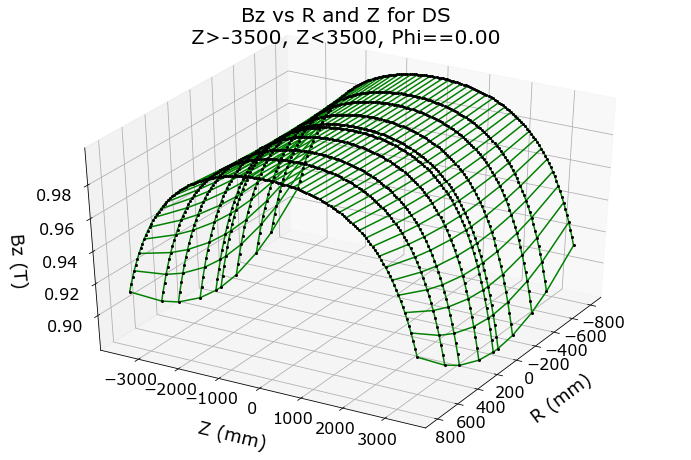

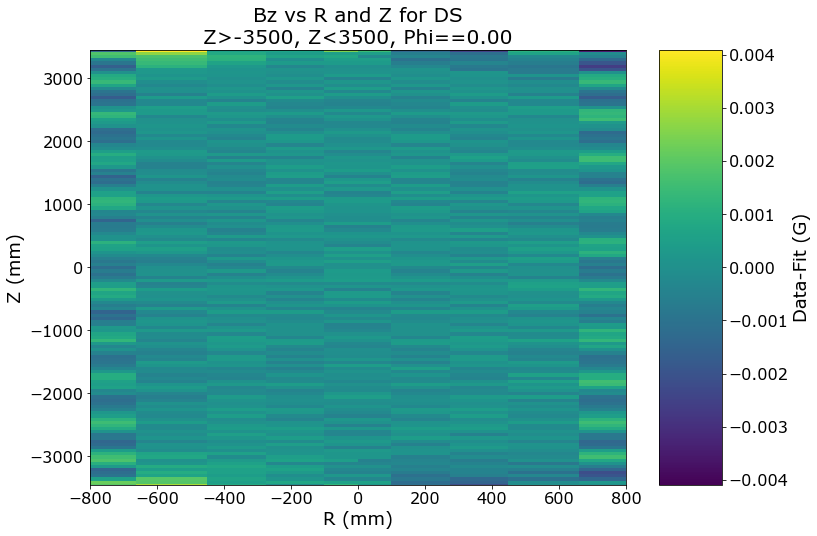

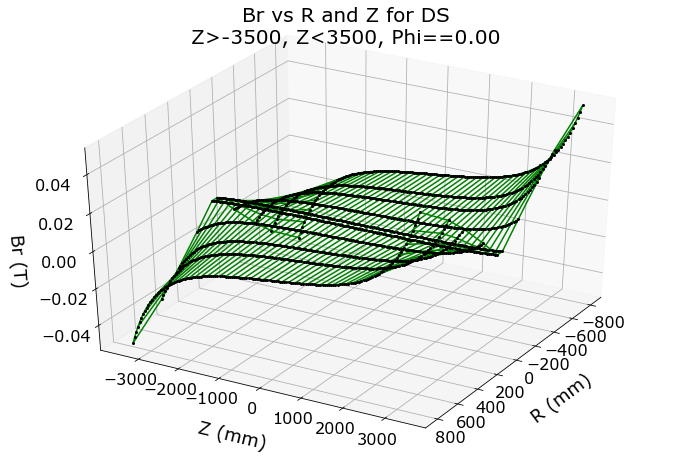

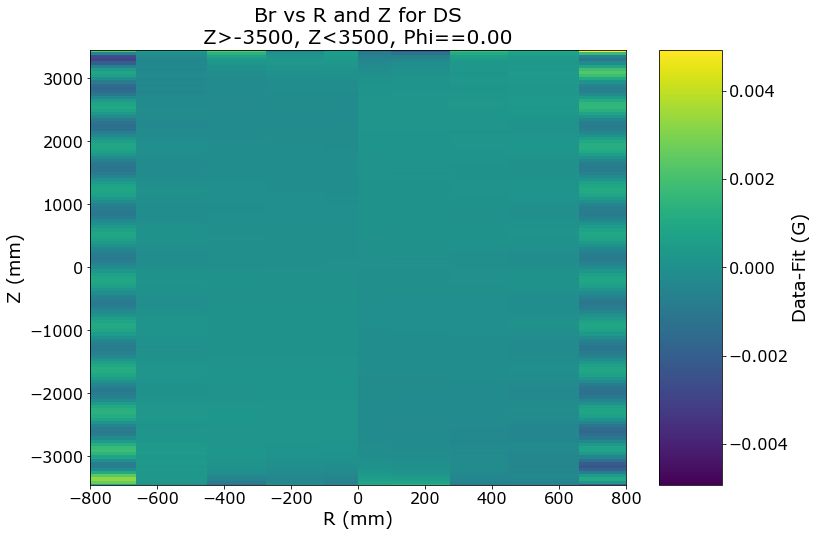

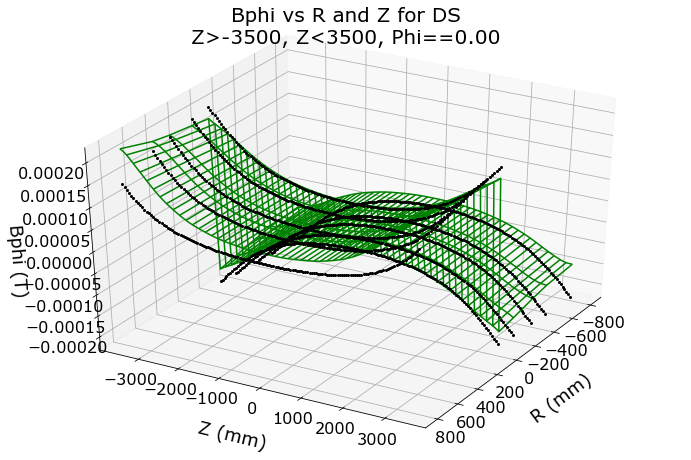

...

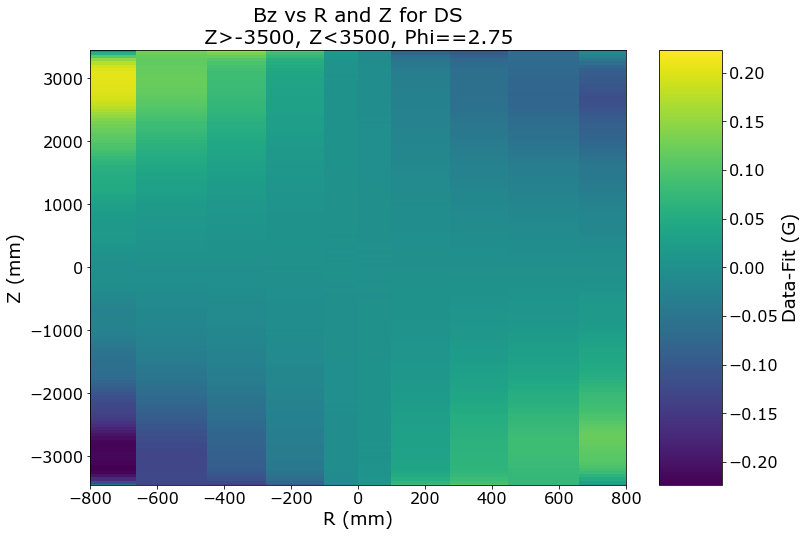

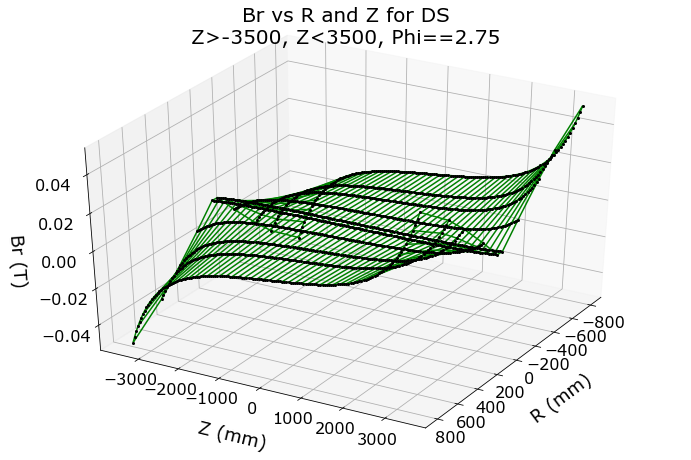

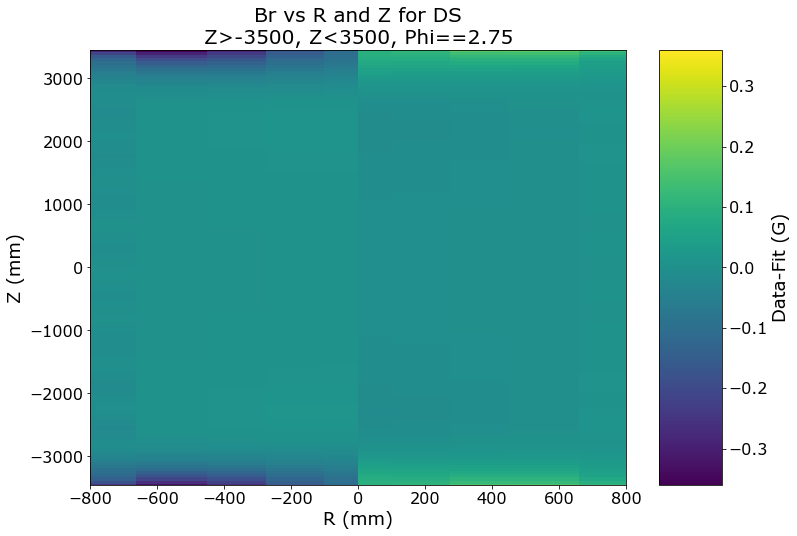

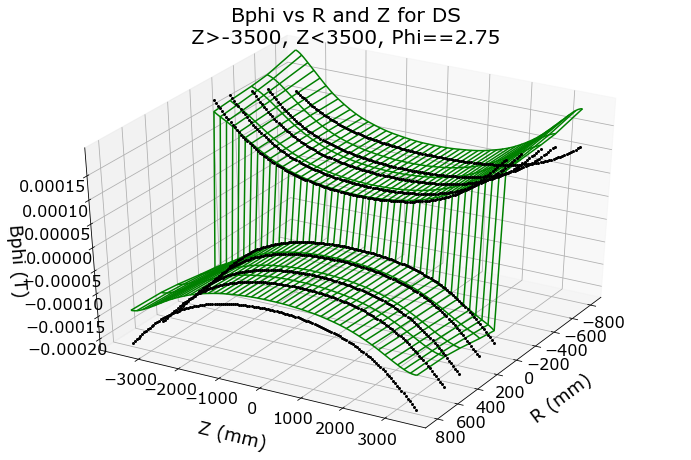

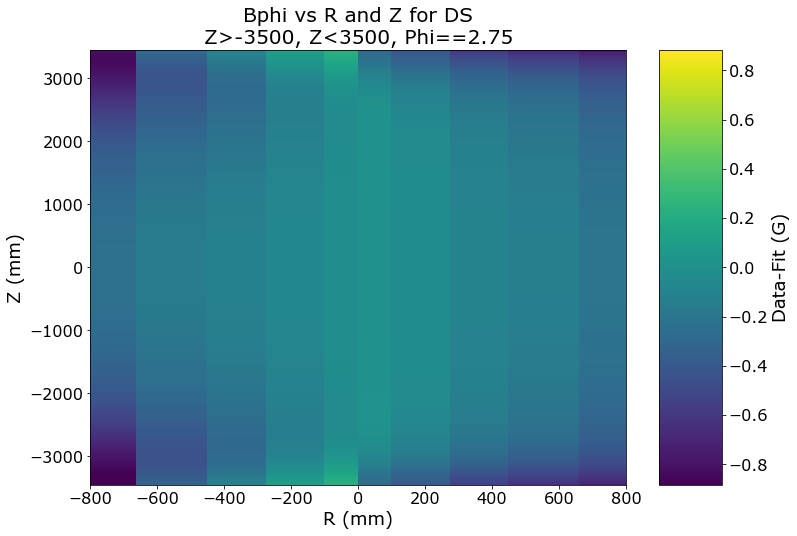

In [31]:
cfg_params_Cole_DS_Hel        = cfg_params(ns=3, ms=15, cns=0, cms=0, nms=0, Reff=7000,
                                                  n_scale=1, m_scale=1, func_version=6)
hmd, ff = field_map_analysis('halltoy_Cole_Hel', cfg_data_DS_Cole_Hel_true2,
                                  cfg_geom_hel_true, cfg_params_Cole_DS_Hel,
                                  cfg_pickle_Cole_Hel, cfg_plot_mpl)

fitting with n=15, m=3, cn=0, cm=0
`ftol` termination condition is satisfied.
Function evaluations 31, initial cost 5.3126e+03, final cost 4.2932e-06, first-order optimality 3.35e-07.
Elapsed time was 32.1691 seconds
[[Fit Statistics]]
    # fitting method   = least_squares
    # function evals   = 32
    # data points      = 33600
    # variables        = 94
    chi-square         = 0.00001
    reduced chi-square = 0.00000
    Akaike info crit   = -741955.66254
    Bayesian info crit = -741163.96809
[[Variables]]
    R:        13000 (fixed)
    ns:       15 (fixed)
    ms:       3 (fixed)
    A_0_0:    0 (fixed)
    B_0_0:    0 (fixed)
    A_0_1:    0 (fixed)
    B_0_1:    0 (fixed)
    A_0_2:    0 (fixed)
    B_0_2:    0 (fixed)
    A_1_0:    1051.67980 (init= 0)
    B_1_0:   -193.506747 (init= 0)
    A_1_1:    0.49111389 (init= 0)
    B_1_1:    0.08646262 (init= 0)
    A_1_2:    0.00548002 (init= 0)
    B_1_2:    1.52265418 (init= 0)
    A_2_0:   -230.032585 (init= 0)
    B_2_0:    

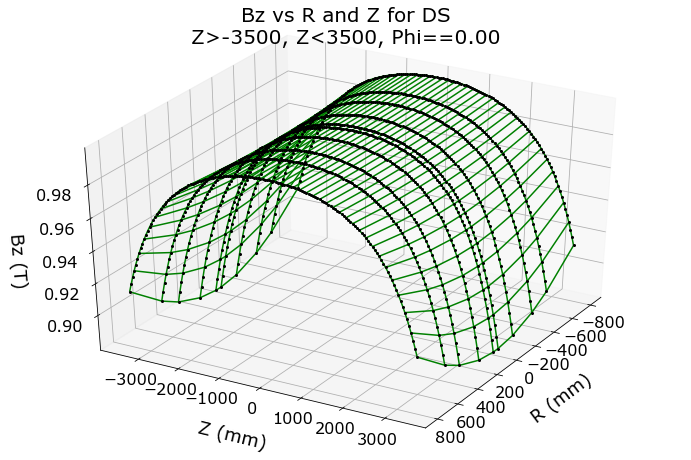

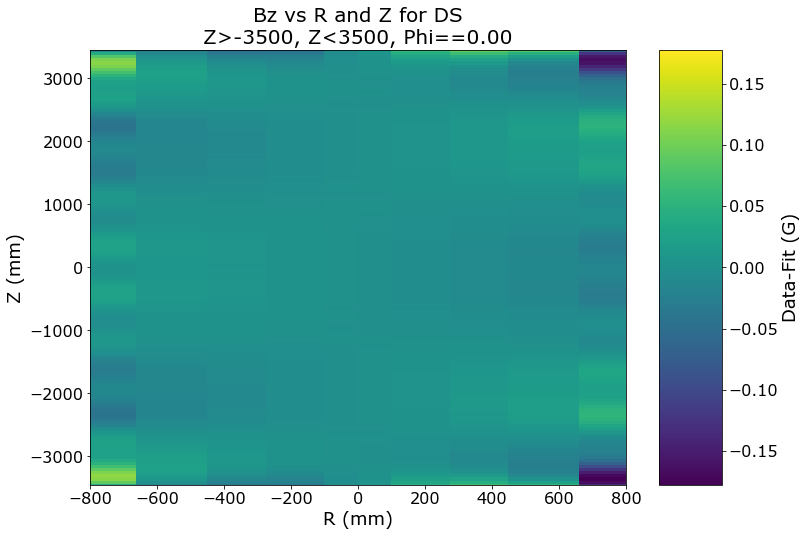

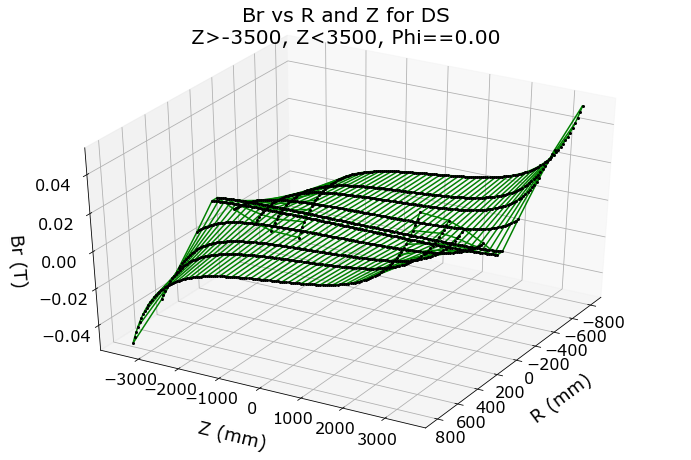

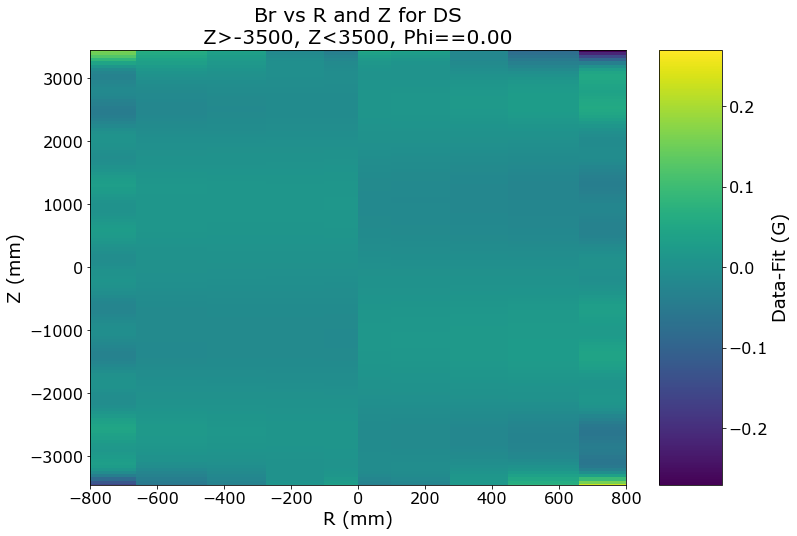

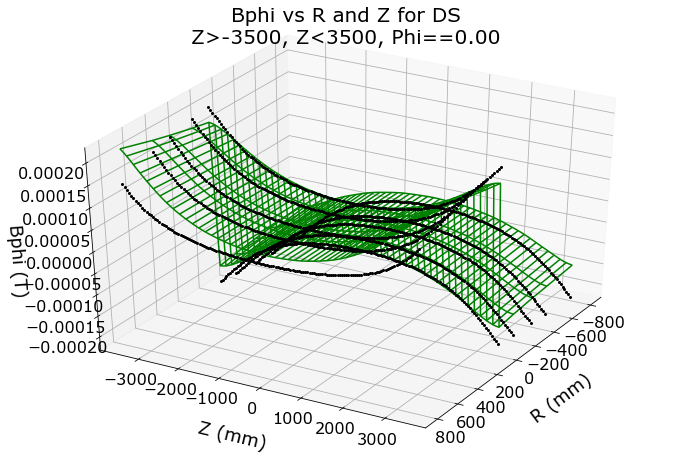

...

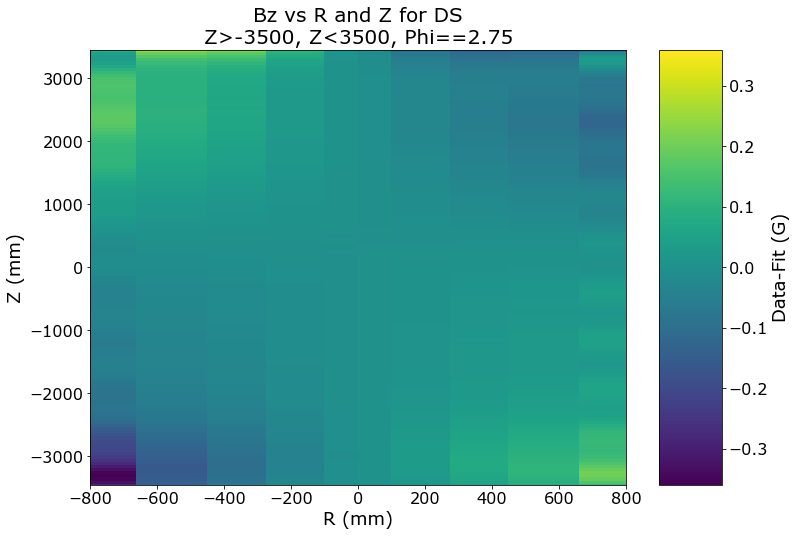

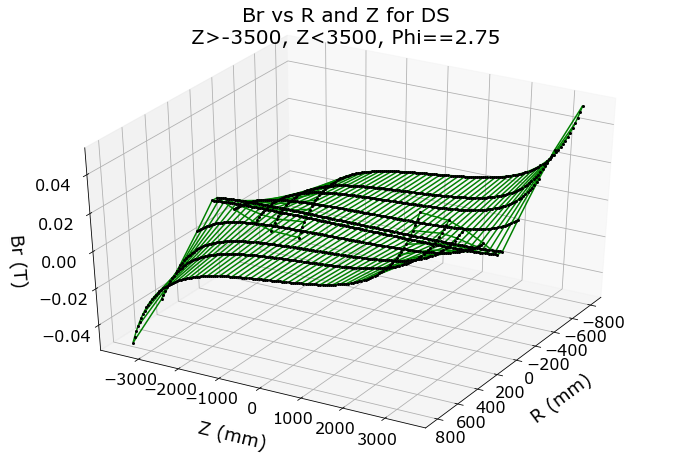

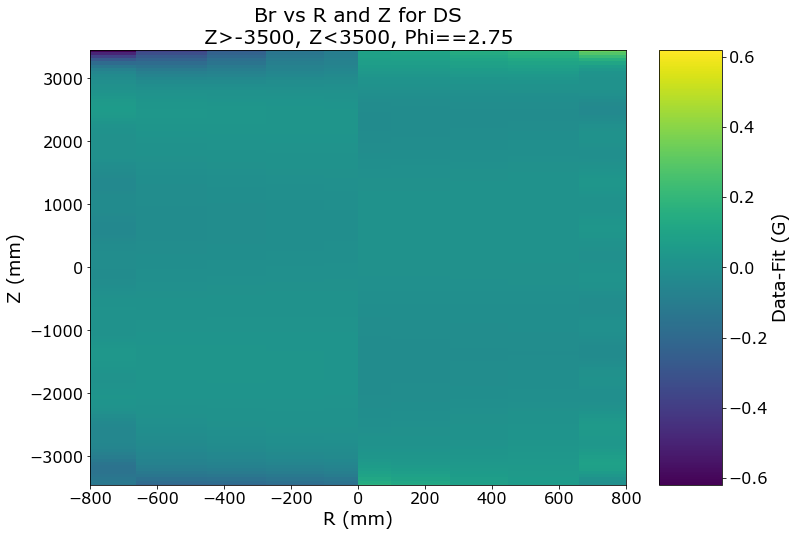

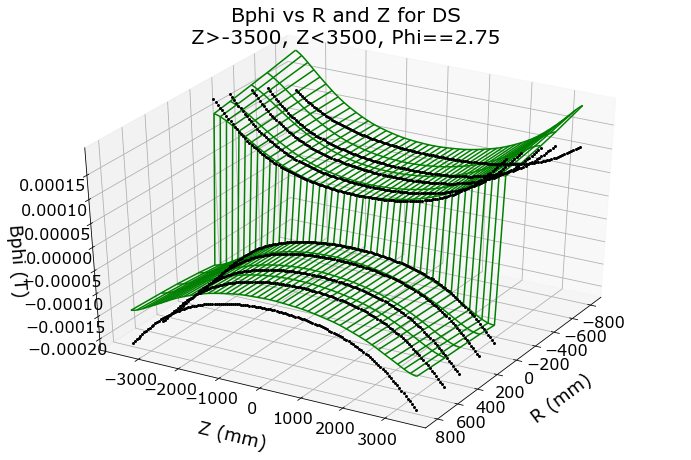

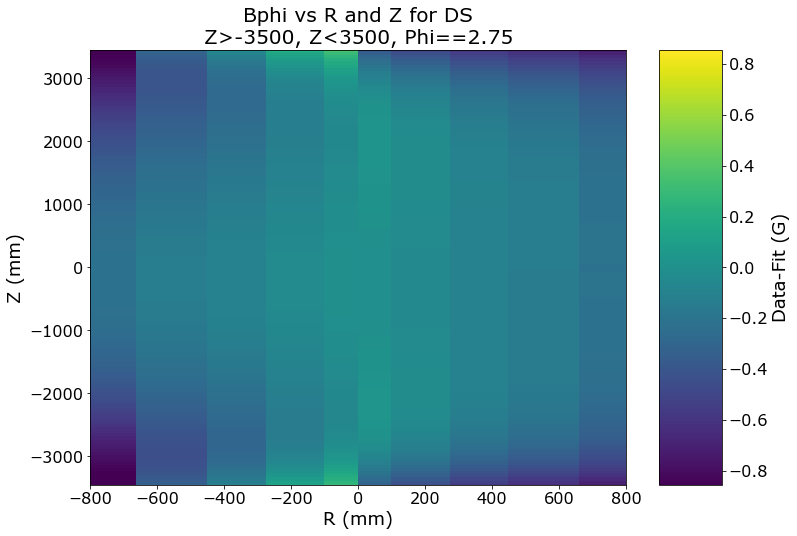

In [33]:
cfg_params_Cole_DS_Hel        = cfg_params(ns=15, ms=3, cns=0, cms=0, nms=0, Reff=13000,
                                                  n_scale=1, m_scale=1, func_version=115)
hmd, ff = field_map_analysis('halltoy_Cole_Hel', cfg_data_DS_Cole_Hel_true2,
                                  cfg_geom_hel_true, cfg_params_Cole_DS_Hel,
                                  cfg_pickle_Cole_Hel, cfg_plot_mpl)

fitting with n=15, m=3, cn=0, cm=0
`ftol` termination condition is satisfied.
Function evaluations 33, initial cost 5.3126e+03, final cost 2.8802e-05, first-order optimality 1.64e-08.
Elapsed time was 13.2907 seconds
[[Fit Statistics]]
    # fitting method   = least_squares
    # function evals   = 34
    # data points      = 33600
    # variables        = 52
    chi-square         = 0.00006
    reduced chi-square = 0.00000
    Akaike info crit   = -678085.06774
    Bayesian info crit = -677647.10911
[[Variables]]
    R:        13000 (fixed)
    ns:       15 (fixed)
    ms:       3 (fixed)
    A_0_0:    0 (fixed)
    B_0_0:    0 (fixed)
    A_0_1:    0 (fixed)
    B_0_1:    0 (fixed)
    A_0_2:    0 (fixed)
    B_0_2:    0 (fixed)
    A_1_0:    0 (fixed)
    B_1_0:    509.927831 (init= 0)
    A_1_1:    0 (fixed)
    B_1_1:    0.04533374 (init= 0)
    A_1_2:    0 (fixed)
    B_1_2:    1.52411364 (init= 0)
    A_2_0:    0 (fixed)
    B_2_0:    7.58347563 (init= 0)
    A_2_1:    0 (fixed)

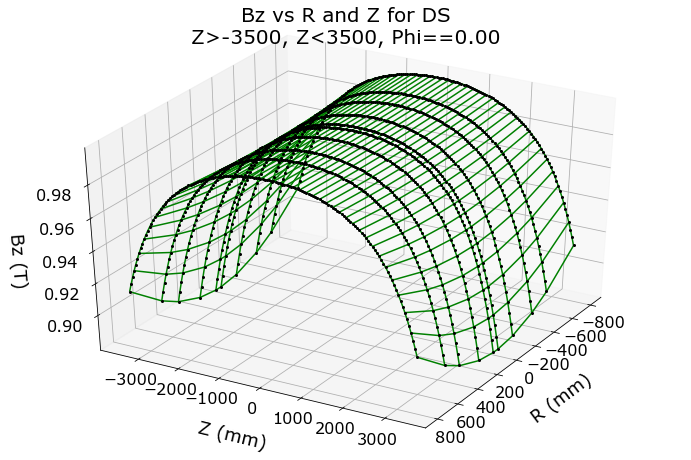

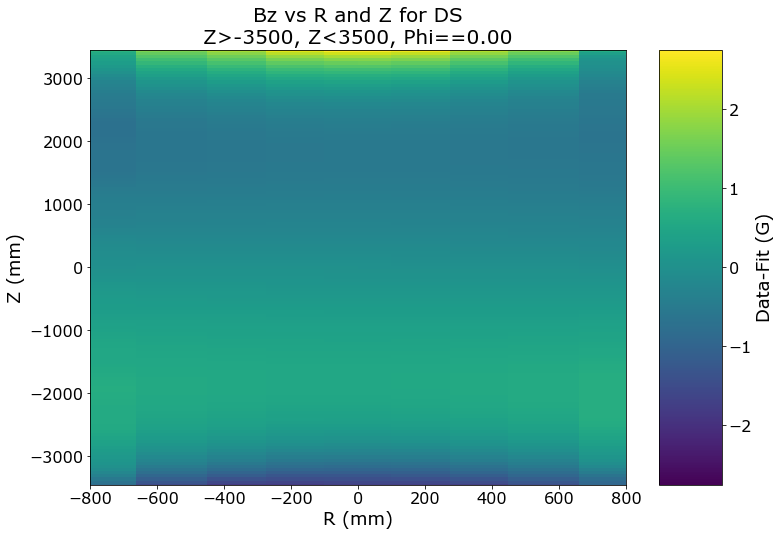

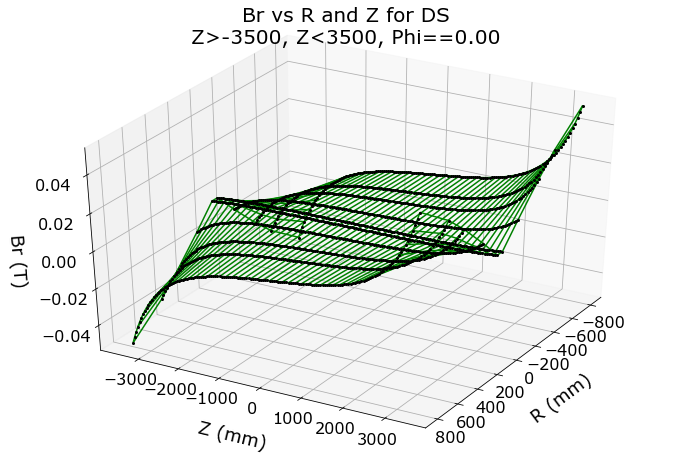

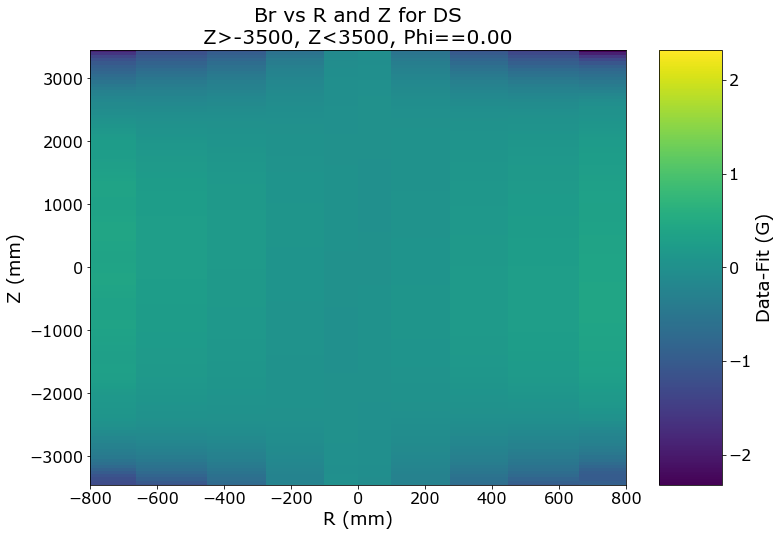

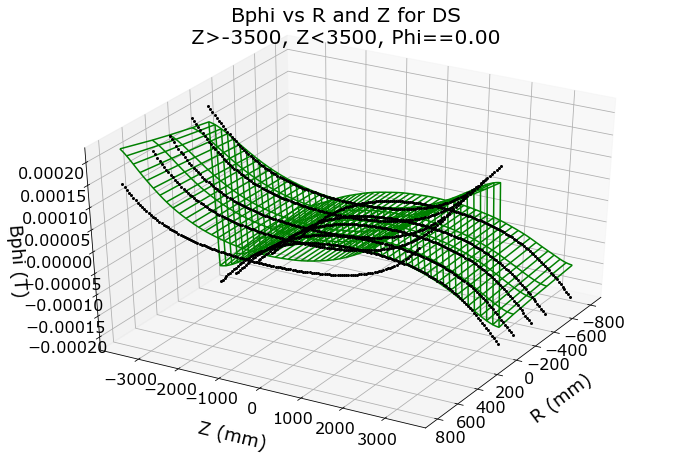

...

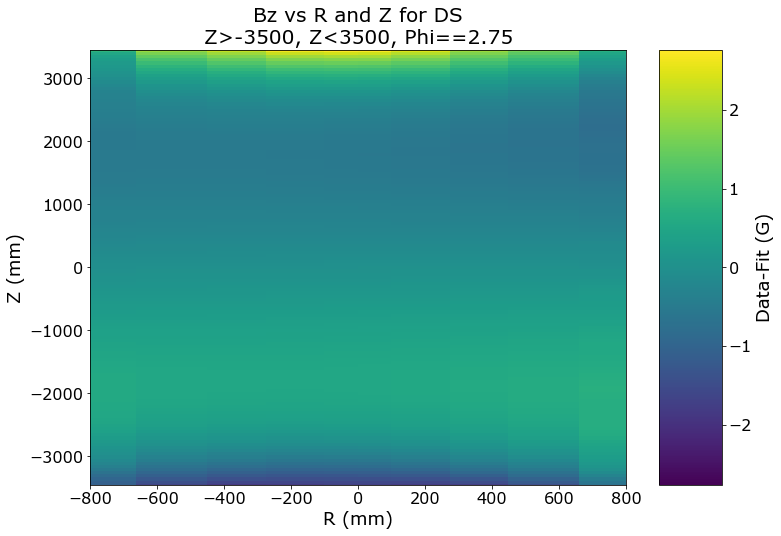

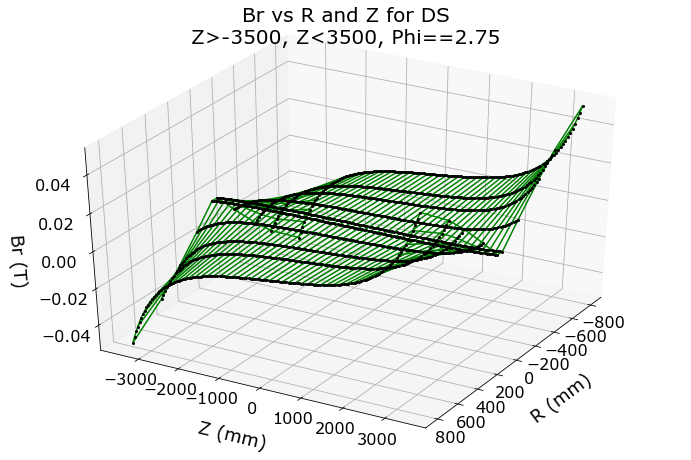

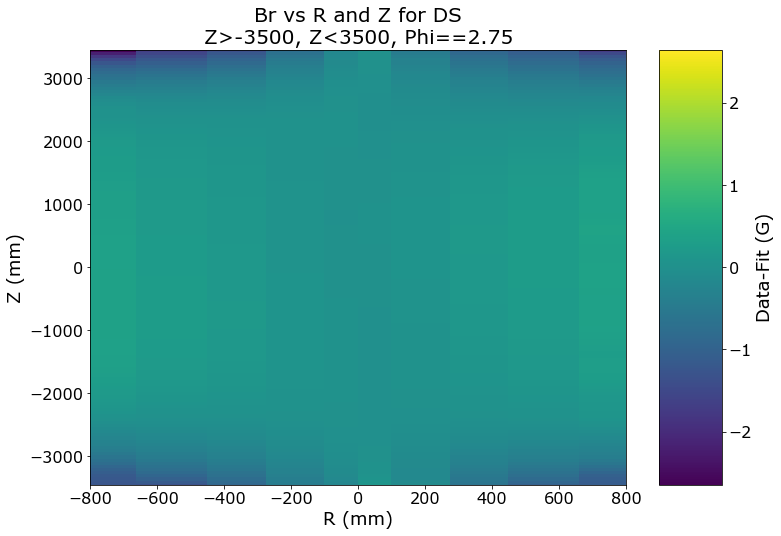

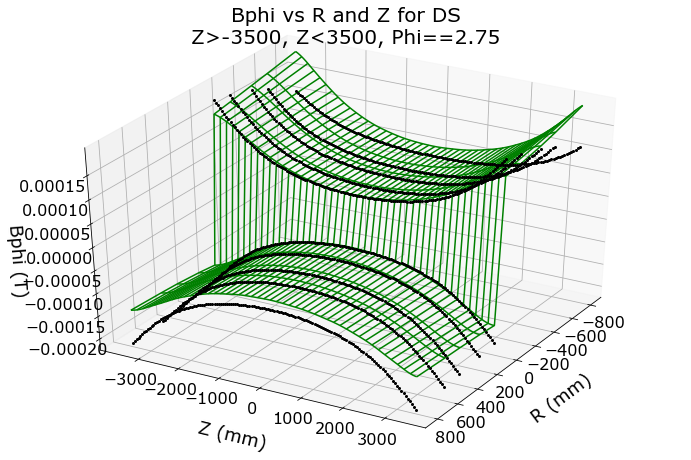

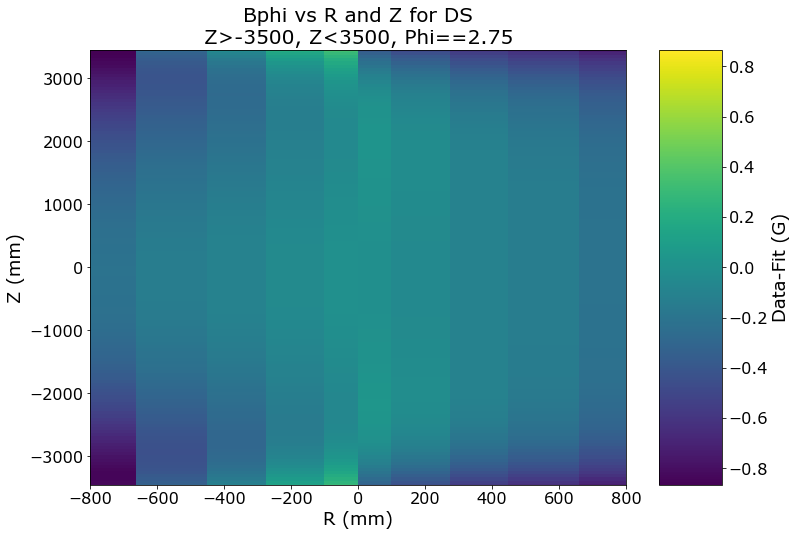

In [34]:
cfg_params_Cole_DS_Hel        = cfg_params(ns=15, ms=3, cns=0, cms=0, nms=0, Reff=13000,
                                                  n_scale=1, m_scale=1, func_version=115)
hmd, ff = field_map_analysis('halltoy_Cole_Hel', cfg_data_DS_Cole_Hel_true2,
                                  cfg_geom_hel_true, cfg_params_Cole_DS_Hel,
                                  cfg_pickle_Cole_Hel, cfg_plot_mpl)

fitting with n=15, m=3, cn=0, cm=0
`ftol` termination condition is satisfied.
Function evaluations 38, initial cost 5.3126e+03, final cost 5.4586e+00, first-order optimality 1.53e-06.
Elapsed time was 19.8085 seconds
[[Fit Statistics]]
    # fitting method   = least_squares
    # function evals   = 39
    # data points      = 33600
    # variables        = 52
    chi-square         = 10.91725
    reduced chi-square = 0.00033
    Akaike info crit   = -269769.09960
    Bayesian info crit = -269331.14097
[[Variables]]
    R:        13000 (fixed)
    ns:       15 (fixed)
    ms:       3 (fixed)
    A_0_0:    0 (fixed)
    B_0_0:    0 (fixed)
    A_0_1:    0 (fixed)
    B_0_1:    0 (fixed)
    A_0_2:    0 (fixed)
    B_0_2:    0 (fixed)
    A_1_0:   -12928.2326 (init= 0)
    B_1_0:    0 (fixed)
    A_1_1:   -3.34053022 (init= 0)
    B_1_1:    0 (fixed)
    A_1_2:    198.024779 (init= 0)
    B_1_2:    0 (fixed)
    A_2_0:    31067.1771 (init= 0)
    B_2_0:    0 (fixed)
    A_2_1:    2.653901

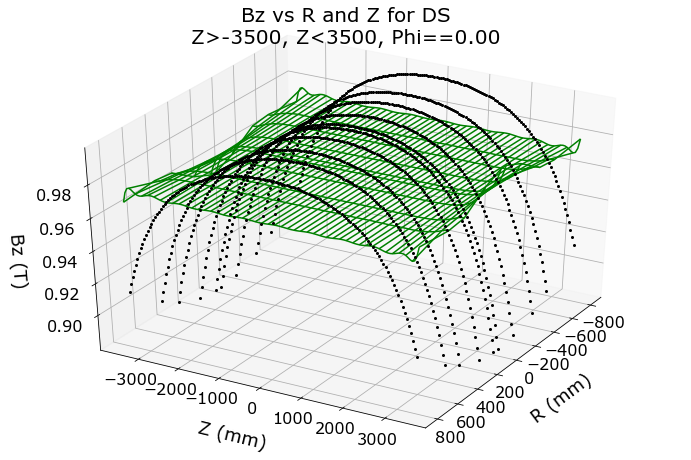

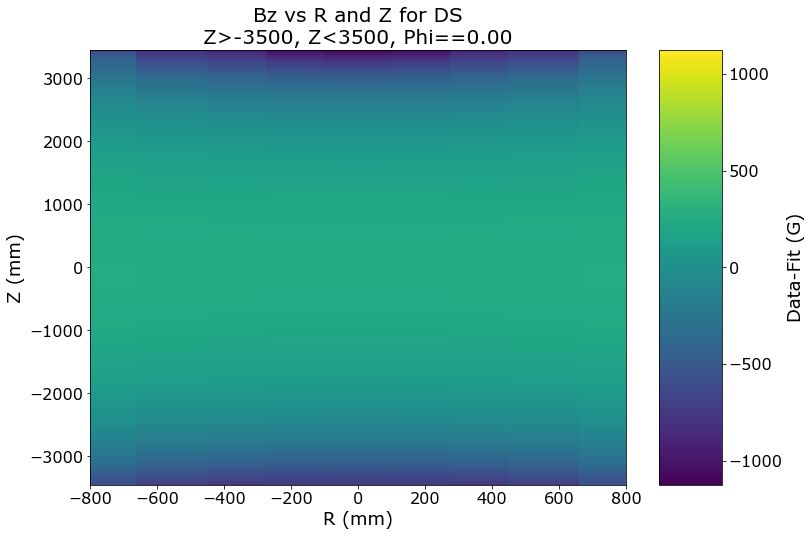

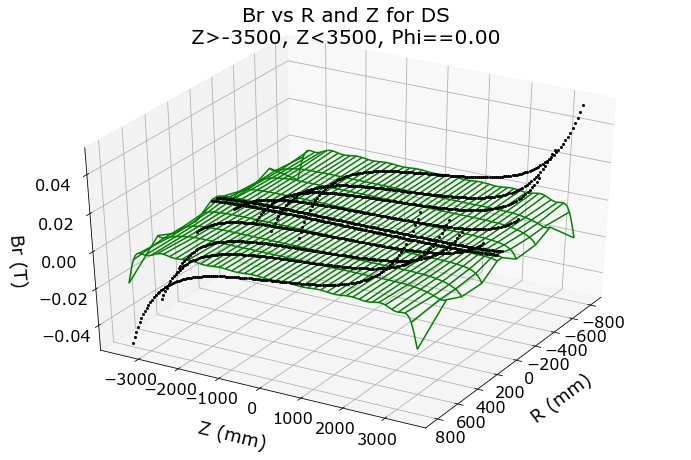

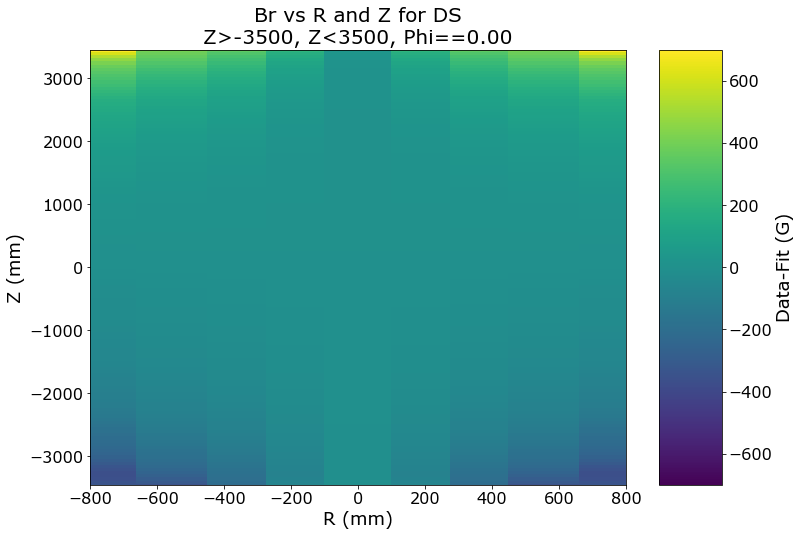

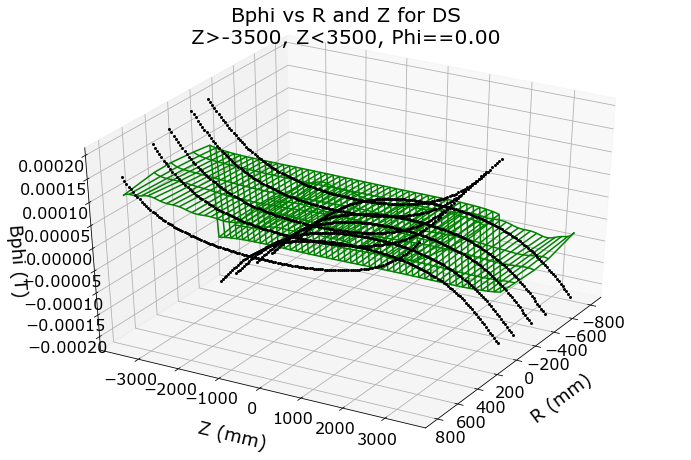

...

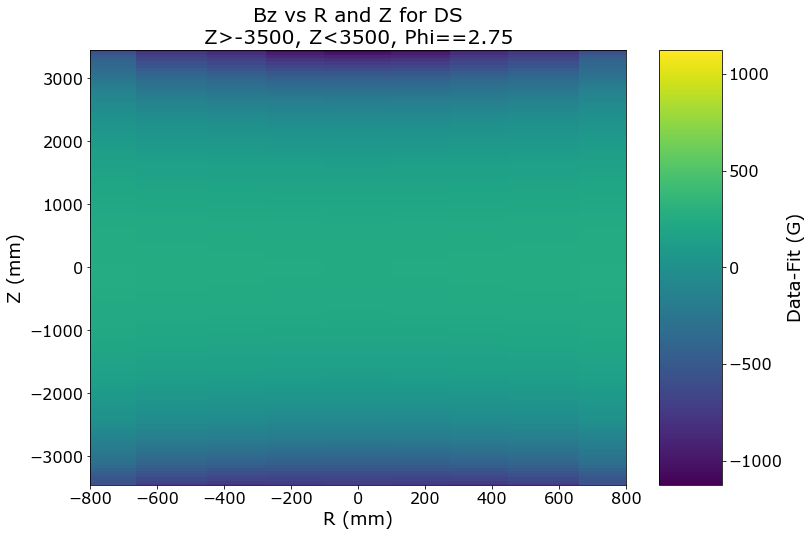

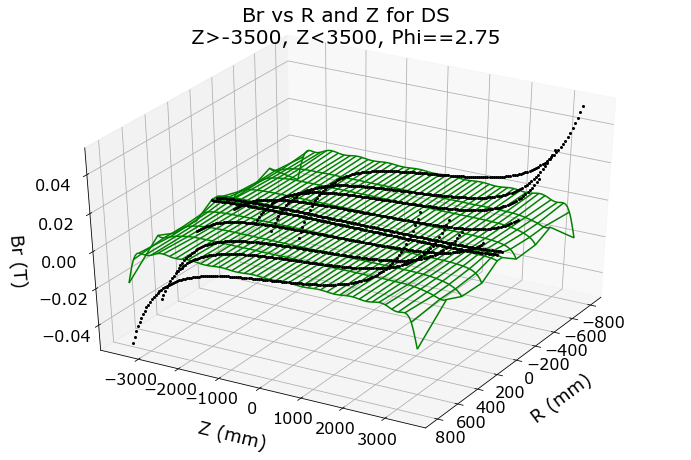

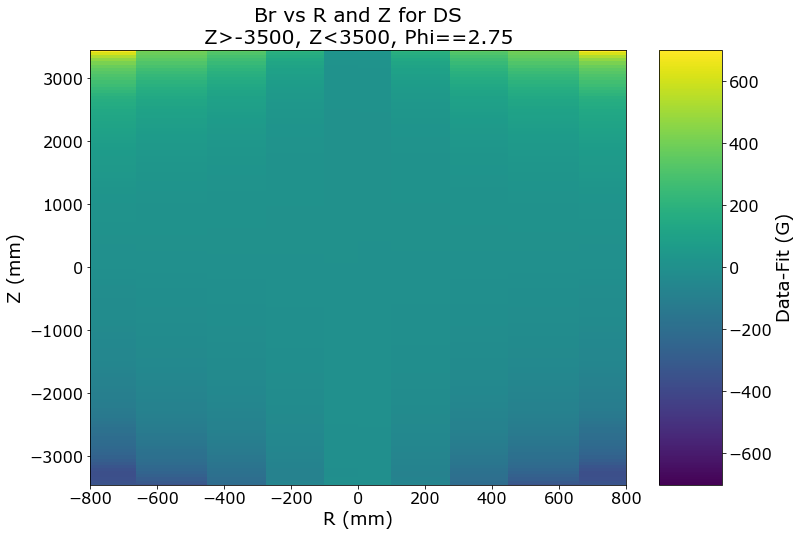

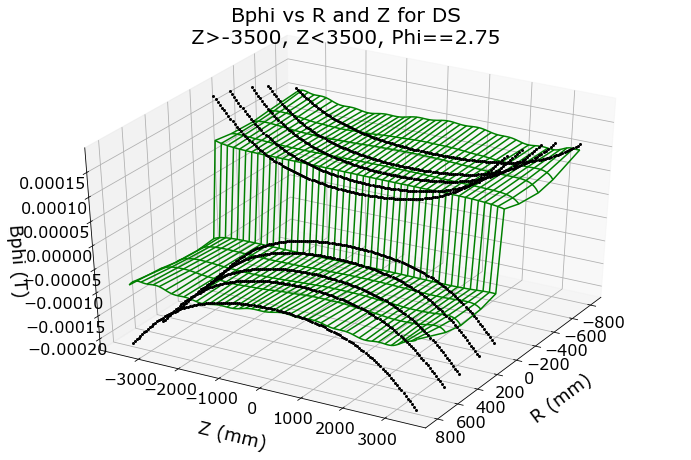

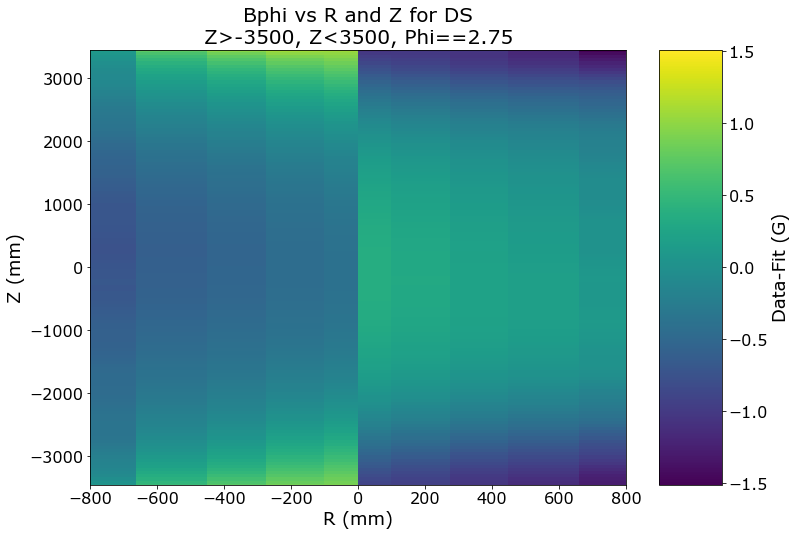

In [35]:
cfg_params_Cole_DS_Hel        = cfg_params(ns=15, ms=3, cns=0, cms=0, nms=0, Reff=13000,
                                                  n_scale=1, m_scale=1, func_version=115)
hmd, ff = field_map_analysis('halltoy_Cole_Hel', cfg_data_DS_Cole_Hel_true2,
                                  cfg_geom_hel_true, cfg_params_Cole_DS_Hel,
                                  cfg_pickle_Cole_Hel, cfg_plot_mpl)

In [ ]:
labs=[i[2:] for i in ff1.params if ('A' in i and ff1.params[i].vary==True and i.split('_')[1] != '0')]

As_1=[ff1.params[i].value for i in ff1.params if ('A' in i and ff1.params[i].vary==True and i.split('_')[1] != '0')]
As_2=[ff2.params[i].value for i in ff2.params if ('A' in i and ff2.params[i].vary==True and i.split('_')[1] != '0')]
As_3=[ff3.params[i].value for i in ff3.params if ('A' in i and ff3.params[i].vary==True and i.split('_')[1] != '0')]


Bs_1=[ff1.params[i].value for i in ff1.params if ('B' in i and ff1.params[i].vary==True and i.split('_')[1] != '0')]
Bs_2=[ff2.params[i].value for i in ff2.params if ('B' in i and ff2.params[i].vary==True and i.split('_')[1] != '0')]
Bs_3=[ff3.params[i].value for i in ff3.params if ('B' in i and ff3.params[i].vary==True and i.split('_')[1] != '0')]

In [ ]:
_ = plt.plot(range(len(As_1)),As_1, 'o-', label='As, phi=0')
_ = plt.plot(range(len(As_1)),As_2, 'o-', label='As, phi=pi/2')
_ = plt.plot(range(len(As_1)),As_3, 'o-', label='As, phi=pi/8')
_ = plt.axhline(0,0, 1, linestyle='--', color='k')

_ = plt.xticks(range(len(As_1)), labs, rotation='vertical')
plt.yscale('symlog')
plt.legend()
plt.title('Free param values for A')

In [ ]:
_ = plt.plot(range(len(Bs_1)),Bs_1, 'o-', label='Bs, phi=0')
_ = plt.plot(range(len(Bs_1)),Bs_2, 'o-', label='Bs, phi=pi/2')
_ = plt.plot(range(len(Bs_1)),Bs_3, 'o-', label='Bs, phi=pi/8')
_ = plt.axhline(0,0, 1, linestyle='--', color='k')


_ = plt.xticks(range(len(Bs_1)), labs, rotation='vertical')
plt.yscale('symlog')
plt.legend()
plt.title('Free param values for B')

In [ ]:
_ = plt.plot(As_1,As_2, 'o', label='As')
_ = plt.plot(Bs_1,Bs_2, 's', label='Bs')
plt.ylim(-10e7, 10e7)
plt.xlim(-10e7, 10e7)
_ =plt.plot(plt.gca().get_xlim(), plt.gca().get_ylim(), 'k--', zorder=0)
_ =plt.plot(plt.gca().get_xlim(), plt.gca().get_ylim()[::-1], 'k--', zorder=0)

#_ = plt.plot(range(len(Bs_1)),Bs_2, 'o-', label='Bs, 2 slices')
#_ = plt.xticks(range(len(Bs_1)), labs, rotation='vertical')
plt.xscale('symlog')
plt.yscale('symlog')
plt.legend()
plt.title('Free param values, phi=0 vs phi=pi/2')
plt.xlabel('1 slice phi=0')
plt.ylabel('1 slice phi=pi/2')

In [ ]:
_ = plt.plot(As_1,As_3, 'o', color='C2', label='As')
_ = plt.plot(Bs_1,Bs_3, 's', color='C4', label='Bs')
plt.ylim(-10e7, 10e7)
plt.xlim(-10e7, 10e7)
_ =plt.plot(plt.gca().get_xlim(), plt.gca().get_ylim(), 'k--', zorder=0)
_ =plt.plot(plt.gca().get_xlim(), plt.gca().get_ylim()[::-1], 'k--', zorder=0)

#_ = plt.plot(range(len(Bs_1)),Bs_2, 'o-', label='Bs, 2 slices')
#_ = plt.xticks(range(len(Bs_1)), labs, rotation='vertical')
plt.xscale('symlog')
plt.yscale('symlog')
plt.legend()
plt.title('Free param values, phi=0 vs phi=pi/8')
plt.xlabel('1 slice phi=0')
plt.ylabel('1 slice phi=pi/8')

In [ ]:
_ = plt.plot(range(len(Bs_1)),[Bs_1[i]/Bs_2[i] for i in range(len(Bs_2))], 'o-', label='B(phi 0)/B(phi pi/2)')
#_ = plt.plot(range(len(Bs_1)),Bs_1b, 'o-', label='Bs, 1 slice phi=pi/2')
_ = plt.xticks(range(len(Bs_1)), labs, rotation='vertical')
plt.yscale('symlog')
plt.legend()
plt.title('Ratio of B values')

In [ ]:
_ = plt.plot(range(len(As_1)),[As_1[i]/As_2[i] for i in range(len(As_2))], 'o-', label='A(phi 0)/A(phi pi/2)')
#_ = plt.plot(range(len(Bs_1)),Bs_1b, 'o-', label='Bs, 1 slice phi=pi/2')
_ = plt.xticks(range(len(As_1)), labs, rotation='vertical')
plt.yscale('symlog')
plt.legend()
plt.title('Ratio of A values')

In [ ]:
n,m = np.meshgrid(range(11),range(11))
Anm = np.asarray([ff1.params[i] for i in ff1.params if 'A' in i]).reshape(10,10)
Bnm = np.asarray([ff1.params[i] for i in ff1.params if 'B' in i]).reshape(10,10)
Anmb = np.asarray([ff2.params[i] for i in ff1.params if 'A' in i]).reshape(10,10)
Bnmb = np.asarray([ff2.params[i] for i in ff1.params if 'B' in i]).reshape(10,10)
Anm_rat = np.nan_to_num(Anm/Anmb)
Bnm_rat = np.nan_to_num(Bnm/Bnmb)
AB_comb = Anm**2+Bnm**2

In [ ]:
import matplotlib.colors as colors
plt.pcolor(n,m, Anm,
          norm=colors.SymLogNorm(linthresh=0.03, linscale=0.03, vmin=Anm.min(), vmax=Anm.max()))
plt.colorbar()
plt.title('Amn for Phi=0')
plt.xlabel('m')
plt.ylabel('n')
plt.figure()
plt.pcolor(n,m, Bnm,
          norm=colors.SymLogNorm(linthresh=0.03, linscale=0.03, vmin=Bnm.min(), vmax=Bnm.max()))
plt.colorbar()
plt.title('Bmn for Phi=0')
plt.xlabel('m')
plt.ylabel('n')

In [ ]:
import matplotlib.colors as colors
plt.pcolor(n,m, abs(Anm),
          norm=colors.SymLogNorm(linthresh=0.03, linscale=0.03, vmin=0, vmax=Anm.max()))
plt.colorbar()
plt.title('abs(Amn) for Phi=0')
plt.xlabel('m')
plt.ylabel('n')
plt.figure()
plt.pcolor(n,m, abs(Bnm),
          norm=colors.SymLogNorm(linthresh=0.03, linscale=0.03, vmin=0, vmax=Bnm.max()))
plt.colorbar()
plt.title('abs(Bmn) for Phi=0')
plt.xlabel('m')
plt.ylabel('n')

In [ ]:
import matplotlib.colors as colors
plt.pcolor(n,m, Anm_rat,
          norm=colors.SymLogNorm(linthresh=0.03, linscale=0.03, vmin=Anm_rat.min(), vmax=Anm_rat.max()))
plt.colorbar()
plt.title('Amn (phi=0)/Amn (phi=pi/2)')
plt.xlabel('m')
plt.ylabel('n')
plt.figure()
plt.pcolor(n,m, Bnm_rat,
          norm=colors.SymLogNorm(linthresh=0.03, linscale=0.03, vmin=Bnm_rat.min(), vmax=Bnm_rat.max()))
plt.colorbar()
plt.title('Bmn (phi=0)/Bmn (phi=pi/2)')
plt.xlabel('m')
plt.ylabel('n')

In [ ]:
import matplotlib.colors as colors
plt.pcolor(n,m, AB_comb,
          norm=colors.SymLogNorm(linthresh=0.03, linscale=0.03, vmin=AB_comb.min(), vmax=AB_comb.max()))
plt.colorbar()
plt.title('Anm^2+Bnm^2, phi=0')
plt.xlabel('m')
plt.ylabel('n')

In [ ]:
phis = (0, np.pi/8, np.pi/4, 3*np.pi/8, np.pi/2, 5*np.pi/8, 3*np.pi/4, 7*np.pi/8)

In [ ]:
for i in range(1, 8):
    plt.plot( phis, [a.params[f'A_{i}_1'] for a in ff_list], label=f'A_{i}_1')
plt.title('Free Param vs Phi')
plt.ylabel('Param')
plt.xlabel('Phi')
plt.legend()